# Dataset

In [1]:
import os
import re
import torch
from torchvision.io import read_image
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import ConcatDataset
import pandas as pd
from PIL import Image
from torchvision import transforms
import numpy as np
import matplotlib.pyplot as plt

In [10]:
class CustomDataset(Dataset):
    def __init__(self, image_dir, label_dir, label_number, transformImage=None, transformLabel=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.label_number = label_number
        self.image_files = sorted(os.listdir(image_dir))  # Sort image files alphabetically
        label_files = os.listdir(label_dir)
        pattern = re.compile(r'(\d+)')
        self.label_files = sorted(label_files, key=lambda x: int(pattern.search(x).group()))
        self.transformImage = transformImage
        self.transformLabel = transformLabel
    
    def __len__(self):
        return len(self.image_files)
    
    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.image_files[idx])
        img = Image.open(img_path).convert('RGB')

        if self.transformImage is not None:
            img = self.transformImage(img)

        lbl_path = os.path.join(self.label_dir, self.label_files[idx])
        lbl = Image.open(lbl_path).convert('L')  # Load labels as grayscale
    
        if self.transformImage is not None:
            lbl = self.transformLabel(lbl)

        # Get the pixel data as a NumPy array
        pixel_data = np.array(lbl)

        # Create a binary mask where 2 becomes 1 and everything else becomes 0
        labels = np.where(pixel_data == self.label_number, 1, 0)

        labels = torch.tensor(labels)
        

        return img, labels

# Configuration

In [25]:
# define the number of channels in the input, number of classes,
# and number of levels in the U-Net model
NUM_CHANNELS = 1
NUM_CLASSES = 1
NUM_LEVELS = 3
# initialize learning rate, number of epochs to train for, and the
# batch size
INIT_LR = 0.001
NUM_EPOCHS = 100
BATCH_SIZE = 32
# define the input image dimensions
INPUT_IMAGE_WIDTH = 128
INPUT_IMAGE_HEIGHT = 128
# define threshold to filter weak predictions
THRESHOLD = 0.5
# define the path to the base output directory
BASE_OUTPUT = "output"
# define the path to the output serialized model, model training
# plot, and testing image paths
MODEL_PATH = os.path.join(BASE_OUTPUT, "unet_tgs_salt.pth")
PLOT_PATH = os.path.sep.join([BASE_OUTPUT, "plot.png"])
TEST_PATHS = os.path.sep.join([BASE_OUTPUT, "test_paths.txt"])
CLASS_WEIGHT = False # set to true if you want to use class weights
# determine the device to be used for training and evaluation
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
if DEVICE == "cuda":
    print("Using GPU")
# determine if we will be pinning memory during data loading
PIN_MEMORY = True if DEVICE == "cuda" else False

Using GPU


# Building the U-Net Model in Pytorch

In [4]:
# import the necessary packages
from torch.nn import ConvTranspose2d
from torch.nn import Conv2d
from torch.nn import MaxPool2d
from torch.nn import Module
from torch.nn import ModuleList
from torch.nn import ReLU
from torchvision.transforms import CenterCrop
from torch.nn import functional as F
import torch

In [5]:
class Block(Module):
	def __init__(self, inChannels, outChannels):
		super().__init__()
		# store the convolution and RELU layers
		self.conv1 = Conv2d(inChannels, outChannels, 3)
		self.relu = ReLU()
		self.conv2 = Conv2d(outChannels, outChannels, 3)
	def forward(self, x):
		# apply CONV => RELU => CONV block to the inputs and return it
		return self.conv2(self.relu(self.conv1(x)))

In [6]:
class Encoder(Module):
	def __init__(self, channels=(3, 16, 32, 64)):
		super().__init__()
		# store the encoder blocks and maxpooling layer
		self.encBlocks = ModuleList(
			[Block(channels[i], channels[i + 1])
			 	for i in range(len(channels) - 1)])
		self.pool = MaxPool2d(2)
	def forward(self, x):
		# initialize an empty list to store the intermediate outputs
		blockOutputs = []
		# loop through the encoder blocks
		for block in self.encBlocks:
			# pass the inputs through the current encoder block, store
			# the outputs, and then apply maxpooling on the output
			x = block(x)
			blockOutputs.append(x)
			x = self.pool(x)
		# return the list containing the intermediate outputs
		return blockOutputs

In [7]:
class Decoder(Module):
	def __init__(self, channels=(64, 32, 16)):
		super().__init__()
		# initialize the number of channels, upsampler blocks, and
		# decoder blocks
		self.channels = channels
		self.upconvs = ModuleList(
			[ConvTranspose2d(channels[i], channels[i + 1], 2, 2)
			 	for i in range(len(channels) - 1)])
		self.dec_blocks = ModuleList(
			[Block(channels[i], channels[i + 1])
			 	for i in range(len(channels) - 1)])
	def forward(self, x, encFeatures):
		# loop through the number of channels
		for i in range(len(self.channels) - 1):
			# pass the inputs through the upsampler blocks
			x = self.upconvs[i](x)
			# crop the current features from the encoder blocks,
			# concatenate them with the current upsampled features,
			# and pass the concatenated output through the current
			# decoder block
			encFeat = self.crop(encFeatures[i], x)
			x = torch.cat([x, encFeat], dim=1)
			x = self.dec_blocks[i](x)
		# return the final decoder output
		return x
	def crop(self, encFeatures, x):
		# grab the dimensions of the inputs, and crop the encoder
		# features to match the dimensions
		(_, _, H, W) = x.shape
		encFeatures = CenterCrop([H, W])(encFeatures)
		# return the cropped features
		return encFeatures

In [8]:
class UNet(Module):
	def __init__(self, encChannels=(3, 16, 32, 64),
		 decChannels=(64, 32, 16),
		 nbClasses=1, retainDim=True,
		 outSize=(INPUT_IMAGE_HEIGHT,  INPUT_IMAGE_WIDTH)):
		super().__init__()
		# initialize the encoder and decoder
		self.encoder = Encoder(encChannels)
		self.decoder = Decoder(decChannels)
		# initialize the regression head and store the class variables
		self.head = Conv2d(decChannels[-1], nbClasses, 1)
		self.retainDim = retainDim
		self.outSize = outSize
	def forward(self, x):
		# grab the features from the encoder
		encFeatures = self.encoder(x)
		# pass the encoder features through decoder making sure that
		# their dimensions are suited for concatenation
		decFeatures = self.decoder(encFeatures[::-1][0],
			encFeatures[::-1][1:])
		# pass the decoder features through the regression head to
		# obtain the segmentation mask
		map = self.head(decFeatures)
		# check to see if we are retaining the original output
		# dimensions and if so, then resize the output to match them
		if self.retainDim:
			map = F.interpolate(map, self.outSize)
		# return the segmentation map
		return map

# Training Segmentation Model

In [9]:
# USAGE
# python train.py
# import the necessary packages
from torch.nn import BCEWithLogitsLoss
from torch.optim import Adam
from torch.utils.data import DataLoader
from sklearn.model_selection import train_test_split
from torchvision import transforms
from imutils import paths
from tqdm import tqdm
import matplotlib.pyplot as plt
import torch
import time
import os

In [58]:
label_dir_train = "Training/Labels"
data_dir_train = "Training/Images"

label_dir_test = "Validation/Labels"
data_dir_test = "Validation/Images"

transformImage = transforms.Compose([
    transforms.Resize((INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)),
    transforms.ToTensor(),
])

transformLabel = transforms.Compose([
    transforms.Resize((INPUT_IMAGE_HEIGHT, INPUT_IMAGE_WIDTH)),
])

trainDS  = CustomDataset(data_dir_train, label_dir_train, 1, transformImage=transformImage, transformLabel=transformLabel)
testDS  = CustomDataset(data_dir_test, label_dir_test, 1, transformImage=transformImage, transformLabel=transformLabel)

# create the training and test data loaders
trainLoader = DataLoader(trainDS, shuffle=True,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY)
testLoader = DataLoader(testDS, shuffle=False,
	batch_size=BATCH_SIZE, pin_memory=PIN_MEMORY)

In [26]:
# initialize our UNet model
unet = UNet().to(DEVICE)

# initialize loss function and optimizer. 
if CLASS_WEIGHT is True:
    class_weight_object = 50
    class_weight_tensor = torch.tensor([class_weight_object]).to(DEVICE)  # Move it to the same device as your model
    # Initialize the loss function with class weights
    lossFunc = BCEWithLogitsLoss(pos_weight=class_weight_tensor)
else:
    lossFunc = BCEWithLogitsLoss()


opt = Adam(unet.parameters(), lr=INIT_LR)
# calculate steps per epoch for training and test set
trainSteps = len(trainDS) // BATCH_SIZE
testSteps = len(testDS) // BATCH_SIZE
# initialize a dictionary to store training history
H = {"train_loss": [], "test_loss": []}

In [27]:
# Loop over epochs
print("[INFO] training the network...")
startTime = time.time()
for e in tqdm(range(NUM_EPOCHS)):
    # Set the model in training mode
    unet.train()
    # Initialize the total training and validation loss
    totalTrainLoss = 0
    totalTestLoss = 0
    # Loop over the training set
    for (i, (x, y)) in enumerate(trainLoader):
        y = y.unsqueeze(dim=1).float()
        # Send the input to the device
        (x, y) = (x.to(DEVICE), y.to(DEVICE))
        # Perform a forward pass and calculate the training loss
        pred = unet(x)
        loss = lossFunc(pred, y)
        # First, zero out any previously accumulated gradients, then
        # perform backpropagation, and then update model parameters
        opt.zero_grad()
        loss.backward()
        opt.step()
        # Add the loss to the total training loss so far
        totalTrainLoss += loss.item()  # Use loss.item() to get the scalar value
    # Switch off autograd
    with torch.no_grad():
        # Set the model in evaluation mode
        unet.eval()
        # Loop over the validation set
        for (x, y) in testLoader:
            y = y.unsqueeze(dim=1).float()
            # Send the input to the device
            (x, y) = (x.to(DEVICE), y.to(DEVICE))
            # Make the predictions and calculate the validation loss
            pred = unet(x)
            totalTestLoss += lossFunc(pred, y).item()  # Use loss.item()
    # Calculate the average training and validation loss
    avgTrainLoss = totalTrainLoss / len(trainLoader)  # Calculate the average over all batches
    avgTestLoss = totalTestLoss / len(testLoader)  # Calculate the average over all batches
    # Update your training history (H) with the average losses
    H["train_loss"].append(avgTrainLoss)
    H["test_loss"].append(avgTestLoss)
    # Print the model training and validation information
    print("[INFO] EPOCH: {}/{}".format(e + 1, NUM_EPOCHS))
    print("Train loss: {:.6f}, Test loss: {:.4f}".format(
        avgTrainLoss, avgTestLoss))

# Display the total time needed to perform the training
endTime = time.time()
print("[INFO] total time taken to train the model: {:.2f}s".format(
    endTime - startTime))

[INFO] training the network...


  1%|▊                                                                                 | 1/100 [00:02<04:55,  2.99s/it]

[INFO] EPOCH: 1/100
Train loss: 0.594720, Test loss: 0.2798


  2%|█▋                                                                                | 2/100 [00:05<04:42,  2.88s/it]

[INFO] EPOCH: 2/100
Train loss: 0.186846, Test loss: 0.1835


  3%|██▍                                                                               | 3/100 [00:08<04:38,  2.87s/it]

[INFO] EPOCH: 3/100
Train loss: 0.145227, Test loss: 0.1837


  4%|███▎                                                                              | 4/100 [00:11<04:33,  2.85s/it]

[INFO] EPOCH: 4/100
Train loss: 0.133593, Test loss: 0.1673


  5%|████                                                                              | 5/100 [00:14<04:29,  2.83s/it]

[INFO] EPOCH: 5/100
Train loss: 0.123446, Test loss: 0.1560


  6%|████▉                                                                             | 6/100 [00:17<04:25,  2.82s/it]

[INFO] EPOCH: 6/100
Train loss: 0.113310, Test loss: 0.1552


  7%|█████▋                                                                            | 7/100 [00:20<04:26,  2.86s/it]

[INFO] EPOCH: 7/100
Train loss: 0.114533, Test loss: 0.1532


  8%|██████▌                                                                           | 8/100 [00:23<04:28,  2.92s/it]

[INFO] EPOCH: 8/100
Train loss: 0.109152, Test loss: 0.1515


  9%|███████▍                                                                          | 9/100 [00:26<04:27,  2.94s/it]

[INFO] EPOCH: 9/100
Train loss: 0.107273, Test loss: 0.1519


 10%|████████                                                                         | 10/100 [00:29<04:27,  2.97s/it]

[INFO] EPOCH: 10/100
Train loss: 0.105431, Test loss: 0.1492


 11%|████████▉                                                                        | 11/100 [00:31<04:20,  2.92s/it]

[INFO] EPOCH: 11/100
Train loss: 0.099860, Test loss: 0.1450


 12%|█████████▋                                                                       | 12/100 [00:34<04:15,  2.90s/it]

[INFO] EPOCH: 12/100
Train loss: 0.095446, Test loss: 0.1394


 13%|██████████▌                                                                      | 13/100 [00:37<04:10,  2.88s/it]

[INFO] EPOCH: 13/100
Train loss: 0.094309, Test loss: 0.1451


 14%|███████████▎                                                                     | 14/100 [00:40<04:06,  2.87s/it]

[INFO] EPOCH: 14/100
Train loss: 0.093157, Test loss: 0.1393


 15%|████████████▏                                                                    | 15/100 [00:43<04:02,  2.85s/it]

[INFO] EPOCH: 15/100
Train loss: 0.089691, Test loss: 0.1407


 16%|████████████▉                                                                    | 16/100 [00:46<04:02,  2.89s/it]

[INFO] EPOCH: 16/100
Train loss: 0.090219, Test loss: 0.1382


 17%|█████████████▊                                                                   | 17/100 [00:49<04:01,  2.90s/it]

[INFO] EPOCH: 17/100
Train loss: 0.088304, Test loss: 0.1394


 18%|██████████████▌                                                                  | 18/100 [00:51<03:56,  2.88s/it]

[INFO] EPOCH: 18/100
Train loss: 0.087393, Test loss: 0.1364


 19%|███████████████▍                                                                 | 19/100 [00:54<03:52,  2.87s/it]

[INFO] EPOCH: 19/100
Train loss: 0.087343, Test loss: 0.1346


 20%|████████████████▏                                                                | 20/100 [00:57<03:53,  2.92s/it]

[INFO] EPOCH: 20/100
Train loss: 0.087370, Test loss: 0.1372


 21%|█████████████████                                                                | 21/100 [01:00<03:53,  2.95s/it]

[INFO] EPOCH: 21/100
Train loss: 0.086176, Test loss: 0.1330


 22%|█████████████████▊                                                               | 22/100 [01:03<03:50,  2.95s/it]

[INFO] EPOCH: 22/100
Train loss: 0.087458, Test loss: 0.1317


 23%|██████████████████▋                                                              | 23/100 [01:06<03:47,  2.95s/it]

[INFO] EPOCH: 23/100
Train loss: 0.085877, Test loss: 0.1336


 24%|███████████████████▍                                                             | 24/100 [01:09<03:46,  2.97s/it]

[INFO] EPOCH: 24/100
Train loss: 0.085018, Test loss: 0.1349


 25%|████████████████████▎                                                            | 25/100 [01:12<03:45,  3.00s/it]

[INFO] EPOCH: 25/100
Train loss: 0.084448, Test loss: 0.1315


 26%|█████████████████████                                                            | 26/100 [01:15<03:38,  2.95s/it]

[INFO] EPOCH: 26/100
Train loss: 0.085453, Test loss: 0.1331


 27%|█████████████████████▊                                                           | 27/100 [01:18<03:31,  2.90s/it]

[INFO] EPOCH: 27/100
Train loss: 0.085738, Test loss: 0.1308


 28%|██████████████████████▋                                                          | 28/100 [01:21<03:30,  2.92s/it]

[INFO] EPOCH: 28/100
Train loss: 0.084601, Test loss: 0.1345


 29%|███████████████████████▍                                                         | 29/100 [01:24<03:26,  2.91s/it]

[INFO] EPOCH: 29/100
Train loss: 0.082956, Test loss: 0.1335


 30%|████████████████████████▎                                                        | 30/100 [01:27<03:23,  2.91s/it]

[INFO] EPOCH: 30/100
Train loss: 0.081467, Test loss: 0.1344


 31%|█████████████████████████                                                        | 31/100 [01:30<03:19,  2.90s/it]

[INFO] EPOCH: 31/100
Train loss: 0.082167, Test loss: 0.1338


 32%|█████████████████████████▉                                                       | 32/100 [01:33<03:17,  2.90s/it]

[INFO] EPOCH: 32/100
Train loss: 0.084858, Test loss: 0.1362


 33%|██████████████████████████▋                                                      | 33/100 [01:35<03:12,  2.88s/it]

[INFO] EPOCH: 33/100
Train loss: 0.082934, Test loss: 0.1387


 34%|███████████████████████████▌                                                     | 34/100 [01:38<03:09,  2.88s/it]

[INFO] EPOCH: 34/100
Train loss: 0.081923, Test loss: 0.1315


 35%|████████████████████████████▎                                                    | 35/100 [01:41<03:05,  2.86s/it]

[INFO] EPOCH: 35/100
Train loss: 0.081084, Test loss: 0.1292


 36%|█████████████████████████████▏                                                   | 36/100 [01:44<03:03,  2.86s/it]

[INFO] EPOCH: 36/100
Train loss: 0.078749, Test loss: 0.1289


 37%|█████████████████████████████▉                                                   | 37/100 [01:47<02:58,  2.84s/it]

[INFO] EPOCH: 37/100
Train loss: 0.078685, Test loss: 0.1314


 38%|██████████████████████████████▊                                                  | 38/100 [01:50<02:56,  2.84s/it]

[INFO] EPOCH: 38/100
Train loss: 0.077063, Test loss: 0.1301


 39%|███████████████████████████████▌                                                 | 39/100 [01:52<02:53,  2.85s/it]

[INFO] EPOCH: 39/100
Train loss: 0.076392, Test loss: 0.1333


 40%|████████████████████████████████▍                                                | 40/100 [01:55<02:54,  2.90s/it]

[INFO] EPOCH: 40/100
Train loss: 0.078025, Test loss: 0.1277


 41%|█████████████████████████████████▏                                               | 41/100 [01:59<02:55,  2.97s/it]

[INFO] EPOCH: 41/100
Train loss: 0.077370, Test loss: 0.1287


 42%|██████████████████████████████████                                               | 42/100 [02:01<02:50,  2.93s/it]

[INFO] EPOCH: 42/100
Train loss: 0.074860, Test loss: 0.1337


 43%|██████████████████████████████████▊                                              | 43/100 [02:04<02:44,  2.88s/it]

[INFO] EPOCH: 43/100
Train loss: 0.072805, Test loss: 0.1266


 44%|███████████████████████████████████▋                                             | 44/100 [02:07<02:41,  2.88s/it]

[INFO] EPOCH: 44/100
Train loss: 0.072994, Test loss: 0.1303


 45%|████████████████████████████████████▍                                            | 45/100 [02:10<02:39,  2.91s/it]

[INFO] EPOCH: 45/100
Train loss: 0.072854, Test loss: 0.1326


 46%|█████████████████████████████████████▎                                           | 46/100 [02:13<02:38,  2.93s/it]

[INFO] EPOCH: 46/100
Train loss: 0.072611, Test loss: 0.1283


 47%|██████████████████████████████████████                                           | 47/100 [02:16<02:32,  2.88s/it]

[INFO] EPOCH: 47/100
Train loss: 0.070293, Test loss: 0.1258


 48%|██████████████████████████████████████▉                                          | 48/100 [02:19<02:28,  2.85s/it]

[INFO] EPOCH: 48/100
Train loss: 0.072303, Test loss: 0.1258


 49%|███████████████████████████████████████▋                                         | 49/100 [02:22<02:26,  2.88s/it]

[INFO] EPOCH: 49/100
Train loss: 0.071635, Test loss: 0.1278


 50%|████████████████████████████████████████▌                                        | 50/100 [02:25<02:29,  2.99s/it]

[INFO] EPOCH: 50/100
Train loss: 0.070186, Test loss: 0.1277


 51%|█████████████████████████████████████████▎                                       | 51/100 [02:28<02:25,  2.97s/it]

[INFO] EPOCH: 51/100
Train loss: 0.068168, Test loss: 0.1256


 52%|██████████████████████████████████████████                                       | 52/100 [02:30<02:19,  2.92s/it]

[INFO] EPOCH: 52/100
Train loss: 0.067950, Test loss: 0.1204


 53%|██████████████████████████████████████████▉                                      | 53/100 [02:33<02:15,  2.87s/it]

[INFO] EPOCH: 53/100
Train loss: 0.067819, Test loss: 0.1258


 54%|███████████████████████████████████████████▋                                     | 54/100 [02:36<02:10,  2.84s/it]

[INFO] EPOCH: 54/100
Train loss: 0.068353, Test loss: 0.1266


 55%|████████████████████████████████████████████▌                                    | 55/100 [02:39<02:08,  2.86s/it]

[INFO] EPOCH: 55/100
Train loss: 0.067744, Test loss: 0.1271


 56%|█████████████████████████████████████████████▎                                   | 56/100 [02:42<02:05,  2.84s/it]

[INFO] EPOCH: 56/100
Train loss: 0.065006, Test loss: 0.1285


 57%|██████████████████████████████████████████████▏                                  | 57/100 [02:45<02:01,  2.82s/it]

[INFO] EPOCH: 57/100
Train loss: 0.064771, Test loss: 0.1263


 58%|██████████████████████████████████████████████▉                                  | 58/100 [02:47<01:58,  2.81s/it]

[INFO] EPOCH: 58/100
Train loss: 0.065782, Test loss: 0.1234


 59%|███████████████████████████████████████████████▊                                 | 59/100 [02:50<01:54,  2.79s/it]

[INFO] EPOCH: 59/100
Train loss: 0.064421, Test loss: 0.1213


 60%|████████████████████████████████████████████████▌                                | 60/100 [02:53<01:51,  2.80s/it]

[INFO] EPOCH: 60/100
Train loss: 0.063819, Test loss: 0.1276


 61%|█████████████████████████████████████████████████▍                               | 61/100 [02:56<01:49,  2.80s/it]

[INFO] EPOCH: 61/100
Train loss: 0.065004, Test loss: 0.1243


 62%|██████████████████████████████████████████████████▏                              | 62/100 [02:58<01:46,  2.81s/it]

[INFO] EPOCH: 62/100
Train loss: 0.063248, Test loss: 0.1197


 63%|███████████████████████████████████████████████████                              | 63/100 [03:01<01:44,  2.82s/it]

[INFO] EPOCH: 63/100
Train loss: 0.063355, Test loss: 0.1254


 64%|███████████████████████████████████████████████████▊                             | 64/100 [03:04<01:41,  2.82s/it]

[INFO] EPOCH: 64/100
Train loss: 0.061357, Test loss: 0.1205


 65%|████████████████████████████████████████████████████▋                            | 65/100 [03:07<01:38,  2.81s/it]

[INFO] EPOCH: 65/100
Train loss: 0.059119, Test loss: 0.1236


 66%|█████████████████████████████████████████████████████▍                           | 66/100 [03:10<01:35,  2.81s/it]

[INFO] EPOCH: 66/100
Train loss: 0.060402, Test loss: 0.1247


 67%|██████████████████████████████████████████████████████▎                          | 67/100 [03:13<01:32,  2.81s/it]

[INFO] EPOCH: 67/100
Train loss: 0.059830, Test loss: 0.1226


 68%|███████████████████████████████████████████████████████                          | 68/100 [03:15<01:29,  2.79s/it]

[INFO] EPOCH: 68/100
Train loss: 0.058428, Test loss: 0.1182


 69%|███████████████████████████████████████████████████████▉                         | 69/100 [03:18<01:26,  2.78s/it]

[INFO] EPOCH: 69/100
Train loss: 0.057703, Test loss: 0.1268


 70%|████████████████████████████████████████████████████████▋                        | 70/100 [03:21<01:23,  2.78s/it]

[INFO] EPOCH: 70/100
Train loss: 0.055684, Test loss: 0.1246


 71%|█████████████████████████████████████████████████████████▌                       | 71/100 [03:24<01:21,  2.82s/it]

[INFO] EPOCH: 71/100
Train loss: 0.056579, Test loss: 0.1215


 72%|██████████████████████████████████████████████████████████▎                      | 72/100 [03:27<01:19,  2.83s/it]

[INFO] EPOCH: 72/100
Train loss: 0.058704, Test loss: 0.1201


 73%|███████████████████████████████████████████████████████████▏                     | 73/100 [03:30<01:17,  2.88s/it]

[INFO] EPOCH: 73/100
Train loss: 0.058898, Test loss: 0.1206


 74%|███████████████████████████████████████████████████████████▉                     | 74/100 [03:33<01:15,  2.89s/it]

[INFO] EPOCH: 74/100
Train loss: 0.054968, Test loss: 0.1250


 75%|████████████████████████████████████████████████████████████▊                    | 75/100 [03:35<01:11,  2.86s/it]

[INFO] EPOCH: 75/100
Train loss: 0.054961, Test loss: 0.1237


 76%|█████████████████████████████████████████████████████████████▌                   | 76/100 [03:38<01:08,  2.84s/it]

[INFO] EPOCH: 76/100
Train loss: 0.055542, Test loss: 0.1288


 77%|██████████████████████████████████████████████████████████████▎                  | 77/100 [03:41<01:04,  2.81s/it]

[INFO] EPOCH: 77/100
Train loss: 0.054410, Test loss: 0.1269


 78%|███████████████████████████████████████████████████████████████▏                 | 78/100 [03:44<01:02,  2.84s/it]

[INFO] EPOCH: 78/100
Train loss: 0.052930, Test loss: 0.1221


 79%|███████████████████████████████████████████████████████████████▉                 | 79/100 [03:46<00:58,  2.80s/it]

[INFO] EPOCH: 79/100
Train loss: 0.052169, Test loss: 0.1242


 80%|████████████████████████████████████████████████████████████████▊                | 80/100 [03:49<00:55,  2.79s/it]

[INFO] EPOCH: 80/100
Train loss: 0.052250, Test loss: 0.1303


 81%|█████████████████████████████████████████████████████████████████▌               | 81/100 [03:52<00:53,  2.81s/it]

[INFO] EPOCH: 81/100
Train loss: 0.053749, Test loss: 0.1226


 82%|██████████████████████████████████████████████████████████████████▍              | 82/100 [03:55<00:50,  2.80s/it]

[INFO] EPOCH: 82/100
Train loss: 0.052198, Test loss: 0.1203


 83%|███████████████████████████████████████████████████████████████████▏             | 83/100 [03:58<00:48,  2.82s/it]

[INFO] EPOCH: 83/100
Train loss: 0.052185, Test loss: 0.1235


 84%|████████████████████████████████████████████████████████████████████             | 84/100 [04:00<00:44,  2.81s/it]

[INFO] EPOCH: 84/100
Train loss: 0.052198, Test loss: 0.1238


 85%|████████████████████████████████████████████████████████████████████▊            | 85/100 [04:03<00:41,  2.80s/it]

[INFO] EPOCH: 85/100
Train loss: 0.049958, Test loss: 0.1222


 86%|█████████████████████████████████████████████████████████████████████▋           | 86/100 [04:06<00:40,  2.87s/it]

[INFO] EPOCH: 86/100
Train loss: 0.050369, Test loss: 0.1227


 87%|██████████████████████████████████████████████████████████████████████▍          | 87/100 [04:09<00:38,  2.93s/it]

[INFO] EPOCH: 87/100
Train loss: 0.048616, Test loss: 0.1256


 88%|███████████████████████████████████████████████████████████████████████▎         | 88/100 [04:12<00:35,  2.96s/it]

[INFO] EPOCH: 88/100
Train loss: 0.048437, Test loss: 0.1216


 89%|████████████████████████████████████████████████████████████████████████         | 89/100 [04:15<00:32,  2.95s/it]

[INFO] EPOCH: 89/100
Train loss: 0.047094, Test loss: 0.1208


 90%|████████████████████████████████████████████████████████████████████████▉        | 90/100 [04:18<00:29,  2.95s/it]

[INFO] EPOCH: 90/100
Train loss: 0.046568, Test loss: 0.1180


 91%|█████████████████████████████████████████████████████████████████████████▋       | 91/100 [04:21<00:27,  3.01s/it]

[INFO] EPOCH: 91/100
Train loss: 0.045645, Test loss: 0.1220


 92%|██████████████████████████████████████████████████████████████████████████▌      | 92/100 [04:24<00:23,  2.95s/it]

[INFO] EPOCH: 92/100
Train loss: 0.044326, Test loss: 0.1289


 93%|███████████████████████████████████████████████████████████████████████████▎     | 93/100 [04:27<00:20,  2.97s/it]

[INFO] EPOCH: 93/100
Train loss: 0.045366, Test loss: 0.1232


 94%|████████████████████████████████████████████████████████████████████████████▏    | 94/100 [04:30<00:17,  2.99s/it]

[INFO] EPOCH: 94/100
Train loss: 0.045479, Test loss: 0.1189


 95%|████████████████████████████████████████████████████████████████████████████▉    | 95/100 [04:33<00:14,  2.94s/it]

[INFO] EPOCH: 95/100
Train loss: 0.044816, Test loss: 0.1207


 96%|█████████████████████████████████████████████████████████████████████████████▊   | 96/100 [04:36<00:11,  2.89s/it]

[INFO] EPOCH: 96/100
Train loss: 0.042188, Test loss: 0.1240


 97%|██████████████████████████████████████████████████████████████████████████████▌  | 97/100 [04:39<00:08,  2.87s/it]

[INFO] EPOCH: 97/100
Train loss: 0.042309, Test loss: 0.1187


 98%|███████████████████████████████████████████████████████████████████████████████▍ | 98/100 [04:41<00:05,  2.84s/it]

[INFO] EPOCH: 98/100
Train loss: 0.043009, Test loss: 0.1212


 99%|████████████████████████████████████████████████████████████████████████████████▏| 99/100 [04:44<00:02,  2.82s/it]

[INFO] EPOCH: 99/100
Train loss: 0.044840, Test loss: 0.1167


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [04:47<00:00,  2.88s/it]

[INFO] EPOCH: 100/100
Train loss: 0.043822, Test loss: 0.1227
[INFO] total time taken to train the model: 287.62s


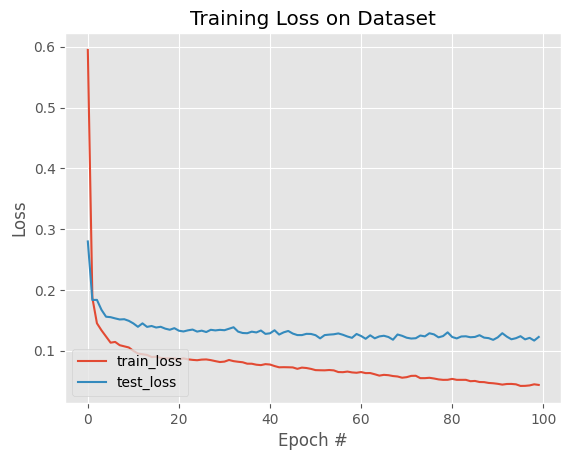

In [28]:
# plot the training loss
plt.style.use("ggplot")
plt.figure()
plt.plot(H["train_loss"], label="train_loss")
plt.plot(H["test_loss"], label="test_loss")
plt.title("Training Loss on Dataset")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="lower left")
plt.savefig(PLOT_PATH)
#serialize the model to disk
torch.save(unet, MODEL_PATH)

# Using the Trained Model for Prediction

In [29]:
# USAGE
# python predict.py
# import the necessary packages
import matplotlib.pyplot as plt
import numpy as np
import torch
import cv2
import os
def prepare_plot(origImage, origMask, predMask,count):
	# initialize our figure
	figure, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 10))
	# plot the original image, its mask, and the predicted mask
	ax[0].imshow(origImage)
	ax[1].imshow(origMask)
	ax[2].imshow(predMask)
	# set the titles of the subplots
	ax[0].set_title("Image")
	ax[1].set_title("Original Mask")
	ax[2].set_title("Predicted Mask")
	# set the layout of the figure and display it
	figure.tight_layout()
	figure.show()
    # Save the visualization image to the specified output directory
	outputImagePath = os.path.join(BASE_OUTPUT, str(count))
	figure.savefig(outputImagePath)

In [30]:
# Dice Score
from sklearn.metrics import f1_score
def dice_coefficient(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred).sum()
    union = y_true.sum() + y_pred.sum()
    
    if union == 0:
        return 1.0  # Handle the case when both masks are empty
    else:
        return 2.0 * intersection / union

In [31]:
def make_predictions(model, imagePath, count):
    # set model to evaluation mode
    model.eval()
    # turn off gradient tracking
    with torch.no_grad():
        # load the image from disk, swap its color channels, cast it
        # to float data type, and scale its pixel values
        image = cv2.imread(imagePath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = image.astype("float32") / 255.0
        # resize the image and make a copy of it for visualization
        image = cv2.resize(image, (128, 128))
        orig = image.copy()
        # find the filename and generate the path to the ground truth mask
        filename = imagePath.split(os.path.sep)[-1]
        groundTruthPath = os.path.join(MASK_DATASET_PATH, filename)
        # load the ground-truth segmentation mask in grayscale mode
        gtMask = cv2.imread(groundTruthPath, 0)
        gtMask = cv2.resize(gtMask, (INPUT_IMAGE_HEIGHT, INPUT_IMAGE_HEIGHT))

        # # Apply thresholding to create the binary mask
        threshold_value = 1  # The value to threshold at
        binary_gtMask = np.where(gtMask == threshold_value, 1, 0)


        # make the channel axis the leading one, add a batch dimension,
        # create a PyTorch tensor, and push it to the current device
        image = np.transpose(image, (2, 0, 1))
        image = np.expand_dims(image, 0)
        image = torch.from_numpy(image).to(DEVICE)

        # make the prediction, pass the results through the sigmoid
        # function, and convert the result to a NumPy array
        predMask = model(image).squeeze()
        predMask = torch.sigmoid(predMask)
        predMask = predMask.cpu().numpy()

        # filter out the weak predictions and convert them to integers
        predMask = (predMask > THRESHOLD) * 255
        predMask = predMask.astype(np.uint8)

        # prepare a plot for visualization
        prepare_plot(orig, binary_gtMask, predMask,count)
        

        dice_score = dice_coefficient(binary_gtMask, predMask)
        return dice_score

[INFO] loading up test image paths...
[INFO] load up model...
Testing/Images\im2_style1Style143_output.png


C:\Users\TAS-CRC\AppData\Local\Temp\ipykernel_3176\3139142840.py:22: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  figure.show()


Testing/Images\im2_style1Style144_output.png
Testing/Images\im2_style1Style145_output.png
Testing/Images\im2_style1Style147_output.png
Testing/Images\im2_style1Style148_output.png
Testing/Images\im2_style1Style149_output.png
Testing/Images\im2_style1Style150_output.png
Testing/Images\im2_style1Style151_output.png
Testing/Images\im2_style1Style152_output.png
Testing/Images\im2_style1Style153_output.png
Testing/Images\im2_style1Style154_output.png
Testing/Images\im2_style1Style155_output.png
Testing/Images\im2_style1Style156_output.png
Testing/Images\im2_style1Style157_output.png
Testing/Images\im2_style1Style158_output.png
Testing/Images\im2_style1Style159_output.png
Testing/Images\im2_style1Style160_output.png
Testing/Images\im2_style1Style161_output.png
Testing/Images\im2_style1Style162_output.png
Testing/Images\im2_style1Style163_output.png
Testing/Images\im2_style1Style164_output.png


C:\Users\TAS-CRC\AppData\Local\Temp\ipykernel_3176\3139142840.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  figure, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 10))


Testing/Images\im2_style1Style165_output.png
Testing/Images\im2_style1Style166_output.png
Testing/Images\im2_style1Style167_output.png
Testing/Images\im2_style1Style168_output.png
Testing/Images\im2_style1Style169_output.png
Testing/Images\im2_style1Style170_output.png
Testing/Images\im2_style1Style171_output.png
Testing/Images\im2_style1Style172_output.png
Testing/Images\im2_style1Style173_output.png
Testing/Images\im2_style1Style174_output.png
Testing/Images\im2_style1Style175_output.png
Testing/Images\im2_style1Style176_output.png
Testing/Images\im2_style1Style177_output.png
Testing/Images\im2_style1Style183_output.png
Testing/Images\im2_style1Style184_output.png
Testing/Images\im2_style1Style185_output.png
Testing/Images\im2_style2Style0_output.png
Testing/Images\im2_style2Style10_output.png
Testing/Images\im2_style2Style11_output.png
Testing/Images\im2_style2Style12_output.png
Testing/Images\im2_style2Style16_output.png
Testing/Images\im2_style2Style20_output.png
Testing/Images\im

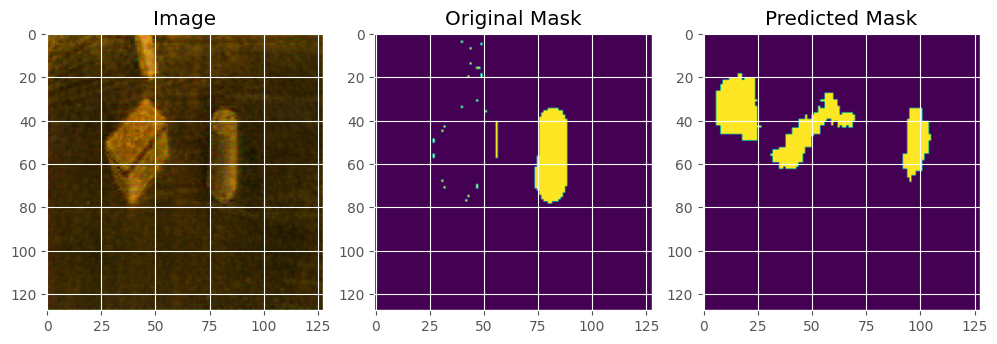

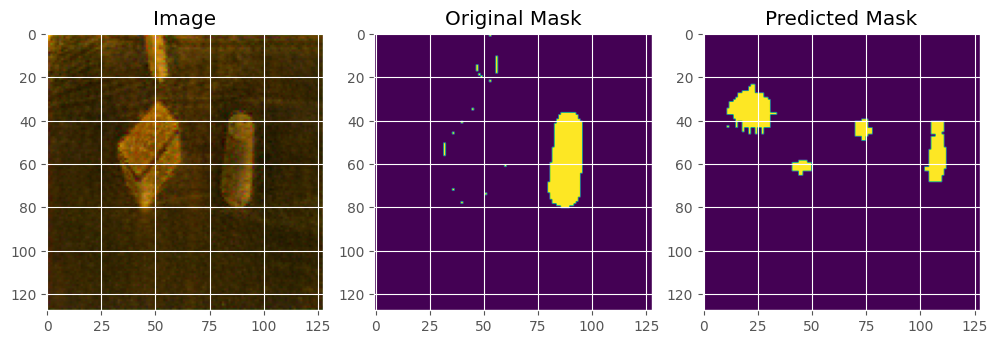

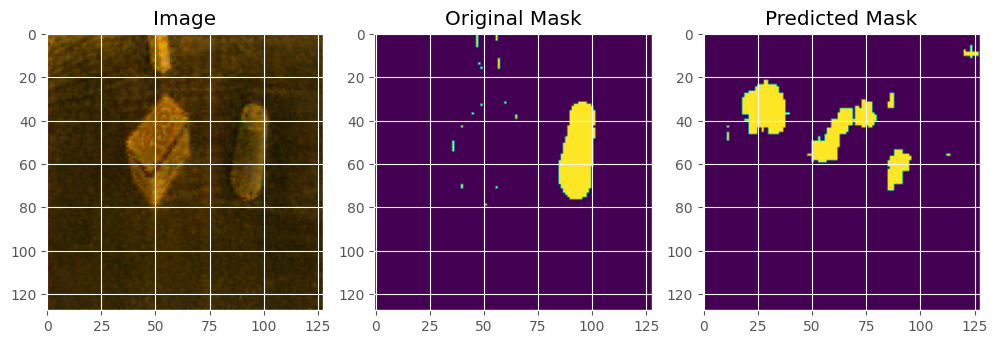

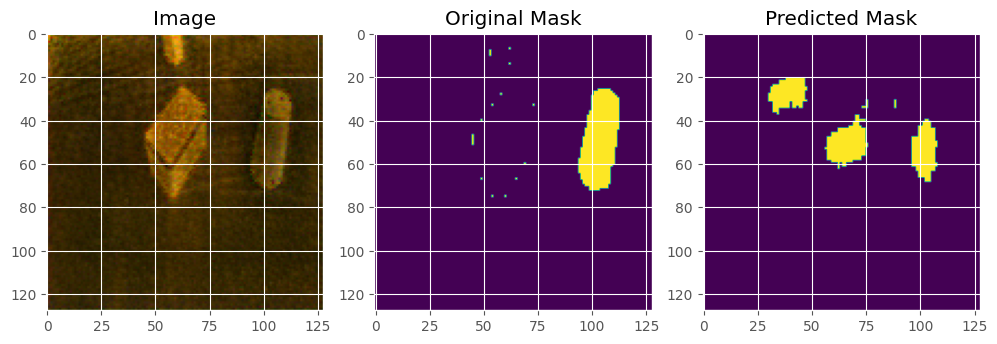

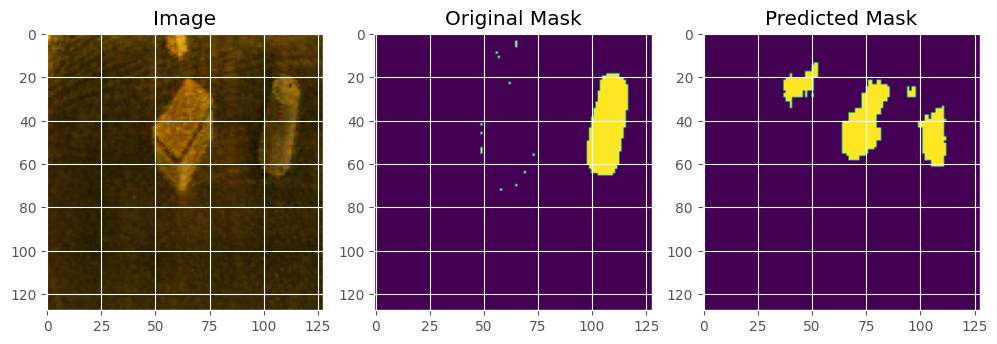

...

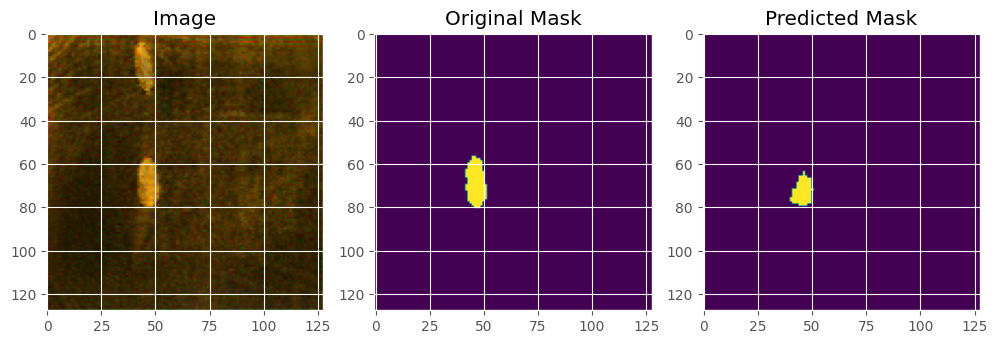

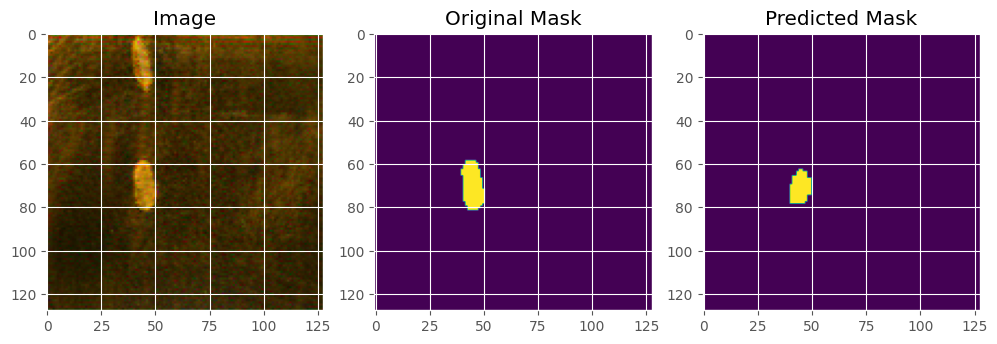

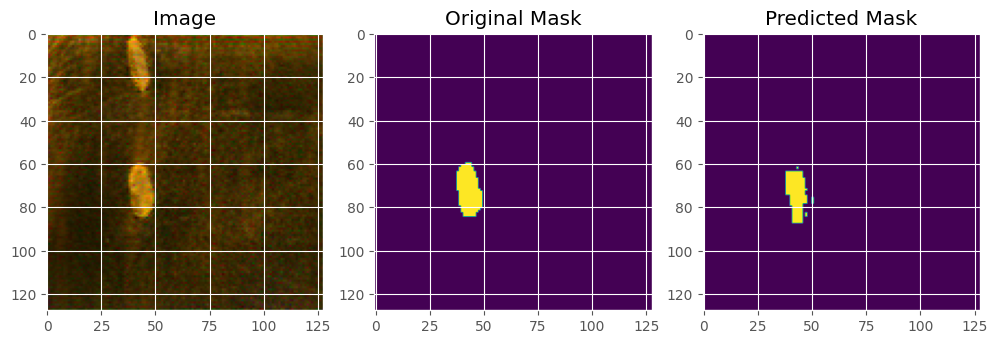

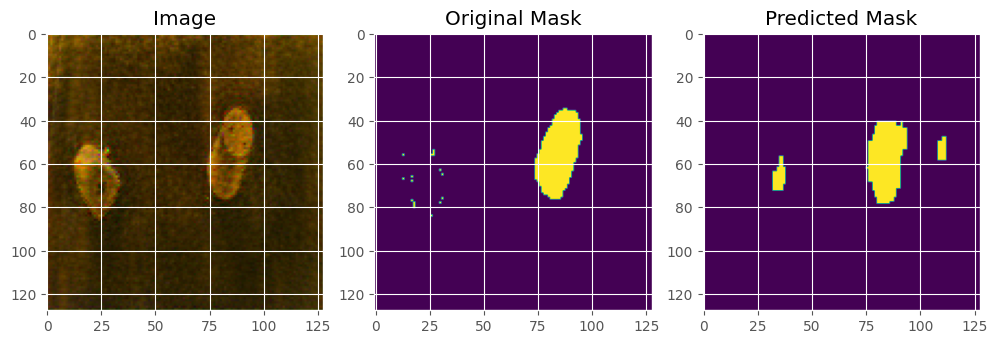

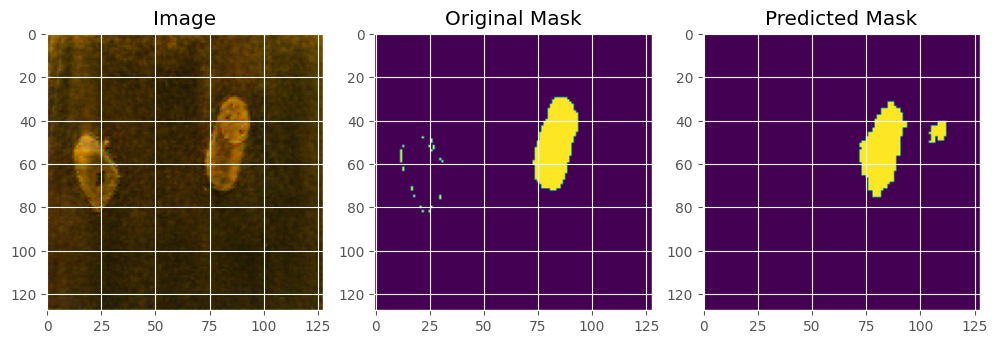

In [32]:
# load the image paths in our testing file and randomly select 10
# image paths
directory =  "Testing/Images"
print("[INFO] loading up test image paths...")
MASK_DATASET_PATH = "Testing/Labels"
# imagePaths = open(TEST_PATHS).read().strip().split("\n")
imagePaths = [os.path.join(directory, filename) for filename in os.listdir(directory) if filename.endswith(('jpg', 'png', 'jpeg'))]
# imagePaths = np.random.choice(imagePaths, size=10)
# load our model from disk and flash it to the current device
print("[INFO] load up model...")
unet = torch.load(MODEL_PATH).to(DEVICE)
# iterate over the randomly selected test image paths
count = 0
score = 0
for path in imagePaths:
	# make predictions and visualize the results
    print(path)
    dice_score = make_predictions(unet, path, count)
    score = score + dice_score
    count = count + 1

averageScore = score/count

In [ ]:
print(f"Dice Score: {averageScore}")

# Mask Visualisation

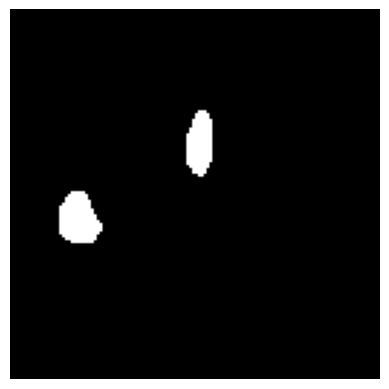

In [59]:
# display black and white image
import matplotlib.pyplot as plt
index = 0
image, mask = testDS[index] 
# Get the width and height of the original image (not labels)
width, height = mask.shape

# Create an empty black image with the same dimensions as the original image
visualization_image = np.zeros((width, height), dtype=np.uint8)

# Iterate through the labels and fill the corresponding pixels in the visualization image
for y in range(width):
    for x in range(height):
        pixel_value = mask[y, x]  # Note the order of y and x
        if pixel_value > 0:
            visualization_image[y, x] = 255  # Set white pixel (255) for value 1

# Display the image using Matplotlib
plt.imshow(visualization_image, cmap='gray')
plt.axis('off')  # Turn off axis labels
plt.show()

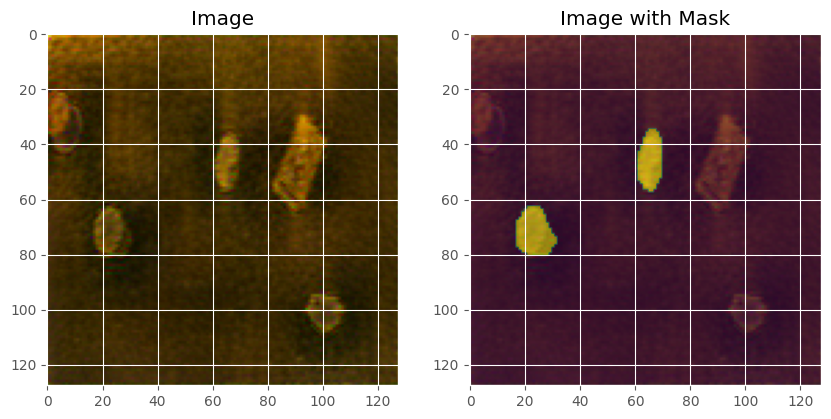

In [60]:
import matplotlib.pyplot as plt

# Define a function to display an image and its mask
def show_image_mask(image, mask):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    
    # Display the image
    axes[0].imshow(image)
    axes[0].set_title('Image')
    
    # Display the mask on top of the image
    axes[1].imshow(image)
    axes[1].imshow(mask, alpha=0.5, cmap='viridis')  # Use a colormap for the mask
    axes[1].set_title('Image with Mask')
    
    plt.show()

# Choose an example from your dataset
image, mask = testDS[index] 

# Visualize the example
show_image_mask(image.permute(1, 2, 0), mask.squeeze())  # Permute the dimensions for Matplotlib